# STAX generates high-resolution 3D point cloud of the mouse embryo brain and simulates coronal, sagittal, and transverse slices

## Load package

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import sys
print(sys.path)
sys.path.append('E:\\学习\\6科研\\论文\\博士论文\\STAX\\code')

['C:\\Users\\10360\\anaconda3\\envs\\py311\\python311.zip', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\DLLs', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\Lib', 'C:\\Users\\10360\\anaconda3\\envs\\py311', '', 'C:\\Users\\10360\\AppData\\Roaming\\Python\\Python311\\site-packages', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\Lib\\site-packages', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\Lib\\site-packages\\win32', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\Lib\\site-packages\\win32\\lib', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\Lib\\site-packages\\Pythonwin']


In [3]:
import scanpy as sc
import pandas as pd
import numpy as np
import torch
import dgl
import random
from scipy.sparse import csr_matrix
from sklearn.metrics import adjusted_rand_score as ari_score
from sklearn.metrics.cluster import normalized_mutual_info_score

In [4]:
import STA as sta

In [5]:
import os

In [6]:
seed = 42
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
np.random.seed(seed)
dgl.random.seed(seed)

In [7]:
sc.set_figure_params(dpi=300, figsize=(4, 4), frameon=False)    # TODO 是否画边框

## 3D mouse embryo brain simulation

### load data

In [6]:
adata1 = sc.read_h5ad(f'brain_magic_dropadd.h5ad')
adata1.obs_names_make_unique()
adata1.var_names_make_unique()
adata1

C:\Users\10360\anaconda3\envs\py311\Lib\site-packages\anndata\_core\anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 97818 × 21311
    obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height'
    var: 'Symbol', 'type', 'ENS'
    obsm: 'spatial', 'spatial_3d_align'
    layers: 'spliced', 'unspliced'

### drop slices

In [9]:
slices = list(adata1.obs.loc[:, 'z'].unique())
len(slices)

93

In [10]:
condition = {item: True if i % 3 == 0 else False for i, item in enumerate(np.sort(slices))}
condition

{16: True,
 21: False,
 31: False,
 36: True,
 41: False,
 56: False,
 66: True,
 71: False,
 77: False,
 89: True,
 95: False,
 101: False,
 107: True,
 113: False,
 119: False,
 132: True,
 156: False,
 162: False,
 168: True,
 174: False,
 180: False,
 186: True,
 194: False,
 200: False,
 207: True,
 213: False,
 235: False,
 241: True,
 249: False,
 255: False,
 261: True,
 266: False,
 271: False,
 276: True,
 281: False,
 286: False,
 291: True,
 296: False,
 301: False,
 306: True,
 317: False,
 321: False,
 327: True,
 332: False,
 337: False,
 342: True,
 346: False,
 351: False,
 357: True,
 361: False,
 366: False,
 371: True,
 377: False,
 381: False,
 387: True,
 391: False,
 396: False,
 403: True,
 408: False,
 414: False,
 426: True,
 432: False,
 438: False,
 444: True,
 451: False,
 457: False,
 464: True,
 471: False,
 477: False,
 483: True,
 489: False,
 495: False,
 501: True,
 507: False,
 513: False,
 519: True,
 525: False,
 531: False,
 537: True,
 543: False

In [11]:
sum([v for v in condition.values()])

31

In [12]:
min(slices), max(slices)

(16, 629)

In [13]:
condition[16] = True
condition[629] = True

In [15]:
adata1.obs.loc[:, 'condition'] = adata1.obs.loc[:, 'z'].apply(lambda x: condition[x])
adata1.obs

,sample,reg,Spot_col,Spot_row,z,region,color_list,color_seq,col,row,height,condition
AGGAATCCCGCTCGAT-z16,5-4,reg4,28,34,16,TelA,#f8e72e,11,309,287,16,True
AGGAATCCTACGCGAG-z16,5-4,reg4,28,33,16,TelA,#f8e72e,11,313,277,16,True
AGGAATCCACGCATCA-z16,5-4,reg4,28,32,16,TelA,#f8e72e,11,316,268,16,True
AGGAATCCTCCGGTAG-z16,5-4,reg4,28,31,16,TelA,#f8e72e,11,320,258,16,True
AGGAATCCCACGCCTA-z16,5-4,reg4,28,30,16,Olfactory_areas,#9c9ede,12,324,248,16,True
...,...,...,...,...,...,...,...,...,...,...,...,...
TCGTGAATACGCATCA-z629,20-9,reg9,9,39,629,Hindbrain,#e377c2,6,474,352,629,True
TCGTGAATTCCGGTAG-z629,20-9,reg9,9,40,629,Hindbrain,#e377c2,6,473,362,629,True
TCGTGAATCACGCCTA-z629,20-9,reg9,9,41,629,Hindbrain,#e377c2,6,472,372,629,True
TCGTGAATAGTGATCG-z629,20-9,reg9,9,42,629,Hindbrain,#e377c2,6,471,383,629,True


In [16]:
adata1_subset = adata1[adata1.obs.loc[:, 'condition'], :]
adata1_subset

View of AnnData object with n_obs × n_vars = 32830 × 21311
    obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition'
    var: 'Symbol', 'type', 'ENS'
    obsm: 'spatial', 'spatial_3d_align'
    layers: 'spliced', 'unspliced'

In [17]:
np.sort(adata1_subset.obs.loc[:, 'z'].unique())

array([ 16,  36,  66,  89, 107, 132, 168, 186, 207, 241, 261, 276, 291,
       306, 327, 342, 357, 371, 387, 403, 426, 444, 464, 483, 501, 519,
       537, 555, 573, 591, 617, 629], dtype=int64)

### make_fake_spot

In [20]:
adata_new = sta.pp.make_fake_spot(adata1_subset, spatial_key='spatial_3d_align', x_density=100, y_density=100, z_slices=123, max_neigh=100)
adata_new

AnnData object with n_obs × n_vars = 583031 × 21311
    obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition', 'spot_quality', 'Region', 'slices'
    obsm: 'spatial', 'spatial_3d_align'
    layers: 'spliced', 'unspliced'

In [21]:
adata_new.obs.loc[:, 'slices'].value_counts()

slices
287.8951721191406     7766
282.95159912109375    7761
297.7822570800781     7671
292.8387145996094     7655
302.7257995605469     7574
                      ... 
89.0                   554
66.0                   409
36.0                   195
16.0                   139
50.60483932495117       97
Name: count, Length: 153, dtype: int64

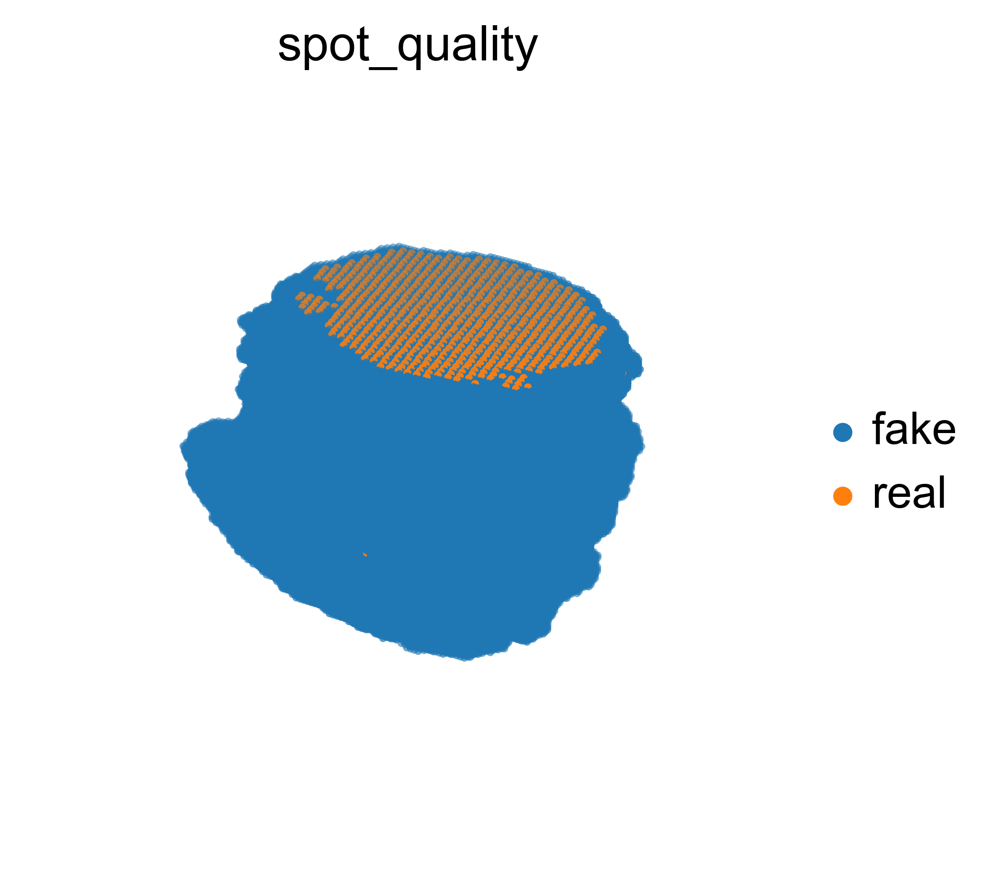

In [22]:
sc.pl.embedding(adata_new, basis='spatial_3d_align', color=['spot_quality'], projection='3d', ncols=2, wspace=0.5, size=5)

In [23]:
slices = list(adata_new.obs.loc[:, 'slices'].unique())
len(slices)

153

In [24]:
data_list = [adata_new[adata_new.obs.slices == slice, :].copy() for slice in slices]
data_list

[AnnData object with n_obs × n_vars = 139 × 21311
     obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition', 'spot_quality', 'Region', 'slices'
     uns: 'spot_quality_colors'
     obsm: 'spatial', 'spatial_3d_align'
     layers: 'spliced', 'unspliced',
 AnnData object with n_obs × n_vars = 195 × 21311
     obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition', 'spot_quality', 'Region', 'slices'
     uns: 'spot_quality_colors'
     obsm: 'spatial', 'spatial_3d_align'
     layers: 'spliced', 'unspliced',
 AnnData object with n_obs × n_vars = 409 × 21311
     obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition', 'spot_quality', 'Region', 'slices'
     uns: 'spot_quality_colors'
     obsm: 'spatial', 'spatial_3d_align'
     layers: 'spliced', 'unspliced',
 AnnData object with n_ob

### process_adata

In [27]:
batch_key = 'batch'
batch_names = slices
adata = sta.pp.process_adata(data_list, label=batch_key, keys=batch_names, n_top_features=5000, norm=True, scale='log', target_sum=1e4, spatial_key='spatial_3d_align')

C:\Users\10360\anaconda3\envs\py311\Lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:172: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["hvg"] = {"flavor": flavor}
C:\Users\10360\anaconda3\envs\py311\Lib\site-packages\scanpy\preprocessing\_normalization.py:234: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))


In [31]:
adata.obs.loc[:, 'x'] = adata.obsm['spatial_3d_align'][:, 0].astype(int)

C:\Users\10360\anaconda3\envs\py311\Lib\site-packages\pandas\core\indexing.py:1857: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  self.obj[key] = value


In [32]:
adata.obs.loc[:, 'y'] = adata.obsm['spatial_3d_align'][:, 1].astype(int)

In [33]:
adata.obs.loc[:, 'z'] = adata.obsm['spatial_3d_align'][:, 2].astype(int)

In [34]:
np.sort(adata.obs.loc[:, 'z'].unique())

array([ 16.,  20.,  25.,  30.,  35.,  36.,  40.,  45.,  50.,  55.,  60.,
        65.,  66.,  70.,  75.,  80.,  85.,  89.,  90.,  95., 100., 104.,
       107., 109., 114., 119., 124., 129., 132., 134., 139., 144., 154.,
       159., 164., 168., 169., 174., 179., 184., 186., 189., 193., 198.,
       203., 207., 208., 213., 218., 228., 233., 238., 241., 243., 248.,
       253., 258., 261., 263., 268., 273., 276., 278., 282., 287., 291.,
       292., 297., 302., 306., 307., 312., 317., 322., 327., 332., 337.,
       342., 347., 352., 357., 362., 366., 371., 376., 381., 386., 387.,
       391., 396., 401., 403., 406., 411., 416., 421., 426., 431., 436.,
       441., 444., 446., 451., 455., 460., 464., 465., 470., 475., 480.,
       483., 485., 490., 495., 500., 501., 505., 510., 515., 519., 520.,
       525., 530., 535., 537., 540., 544., 549., 554., 555., 559., 564.,
       569., 573., 574., 579., 584., 589., 591., 594., 599., 604., 609.,
       614., 617., 619., 624., 629.])

### Construct graph

In [36]:
rad_cutoff_list = [12]
adata, g = sta.pp.process_graph(adata, data_list, cutoff_list=rad_cutoff_list, spatial_key='spatial_3d_align', max_neigh=200)

cal spatial net in one adata
------Calculating spatial graph...
The graph contains 32650662 edges, 583031 cells.
56.0016 neighbors per cell on average.


### Train

In [6]:
path_results = f'./log/simulation13_100100_KD100_rad10/' 

In [39]:
adata_STAX = sta.model.STAX(adata=adata,
                            n_epoch=1000 // 500,
                            batch_size=len(adata) // 1000,
                            verbose=False,
                            gpu=0,
                            random_seed=2024,
                            output_dir=path_results,
                            )

Epochs:   0%|                                                                                                                                                   | 0/2 [00:00<?, ?it/s]C:\Users\10360\anaconda3\envs\py311\Lib\site-packages\dgl\dataloading\dataloader.py:1149: DGLWarning: Dataloader CPU affinity opt is not enabled, consider switching it on (see enable_cpu_affinity() or CPU best practices for DGL [https://docs.dgl.ai/tutorials/cpu/cpu_best_practises.html])
  dgl_warning(
Epochs: 100%|████████████████████████████████████████████████████████████████████████████████████████| 2/2 [14:44<00:00, 442.10s/it, recon_loss_mse=293.8407, kl_loss=2.2527, lr: 0.0]
E:\学习\6科研\论文\博士论文\stMulti\code\stAggregator\trainer.py:105: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimen

### clustering

In [16]:
adata_STAX_fake = adata_STAX[adata_STAX.obs.loc[:, 'spot_quality'] == 'fake', :].copy()
adata_STAX_fake

AnnData object with n_obs × n_vars = 550201 × 5000
    obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition', 'spot_quality', 'Region', 'slices', 'batch', 'x', 'y'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p'
    obsm: 'X_STAX', 'spatial', 'spatial_3d_align'
    varm: 'gene_embedding'
    layers: 'counts', 'impute', 'norm_log', 'spliced', 'unspliced'

In [17]:
sta.tl.kmeans_cluster(adata_STAX_fake, mode='KMeans', used_embedding='X_STAX', n_clusters=40)

E:\学习\6科研\论文\博士论文\STAX\code\STA\tools\clustering.py:79: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['11' '11' '11' ... '11' '11' '11']' has dtype incompatible with int32, please explicitly cast to a compatible dtype first.
  adata.obs.loc[:, 'kmeans'] = adata.obs.loc[:, 'kmeans'].astype(str)


AnnData object with n_obs × n_vars = 550201 × 5000
    obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition', 'spot_quality', 'Region', 'slices', 'batch', 'x', 'y', 'kmeans'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p'
    obsm: 'X_STAX', 'spatial', 'spatial_3d_align'
    varm: 'gene_embedding'
    layers: 'counts', 'impute', 'norm_log', 'spliced', 'unspliced'

In [22]:
# 40
domain_dict = {'0': 'Meninges',   
              '1': 'Olfactory_areas', 
              '2': 'Inter_and_hind_brain',  
              '3': 'Olfactory_areas',
              '4': 'Meninges',   
              '5': 'DPall',  
              '6': 'Mid_brain',   # 
              '7': 'Inter_and_hind_brain', 
              '8': 'Diencephalon',  ### Mid_brain
              '9': 'Ventricular_systems', 
               
              '10': 'MPall',  
              '11': 'Meninges',  
              '12': 'Ventricular_systems', 
              '13': 'DPall',  
              '14': 'DPall',  
              '15': 'Inter_and_hind_brain',  
              '16': 'Inter_and_hind_brain',  
              '17': 'Ventricular_systems', 
              '18': 'Inter_and_hind_brain',  
              '19': 'CSPall', 
               
              '20': 'Olfactory_areas',  ## Olfactory_areas
              '21': 'Inter_and_hind_brain',  
              '22': 'Ventricular_systems',
              '23': 'Meninges',  
              '24': 'Olfactory_areas',   
              '25': 'Inter_and_hind_brain', 
              '26': 'Meninges',  
              '27': 'CSPall', 
              '28': 'Diencephalon',  
              '29': 'DPall',

              '30': 'Meninges',  
              '31': 'Cerebellum', 
              '32': 'Inter_and_hind_brain', 
              '33': 'Meninges',  
              '34': 'Meninges',  
              '35': 'Mid_brain',  
              '36': 'DPall',  
              '37': 'DPall',  
              '38': 'Ventricular_systems',  
              '39': 'Meninges', # 
               
              }

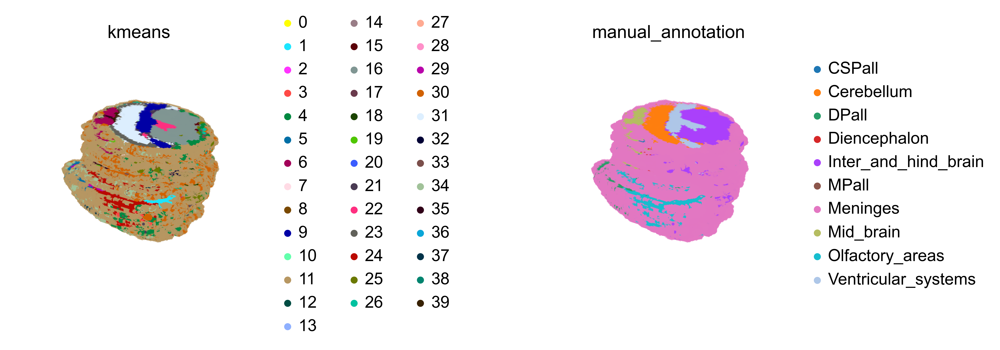

In [30]:
sc.pl.embedding(adata_STAX_fake, basis='spatial_3d_align', color=['kmeans', 'manual_annotation'], projection='3d', ncols=2, wspace=0.5, size=1)

In [31]:
color_d = {'CSPall': '#1f77b4',
 'DPall': '#ff7f0e',
 'MPall': '#279e68',
 'Diencephalon': '#d62728',
 'Mid_brain': '#aa40fc',
 'Inter_and_hind_brain': '#8c564b',
 'Cerebellum': '#e377c2',
 'Meninges': '#b5bd61',
 'Olfactory_areas': '#17becf',
 'Ventricular_systems': '#aec7e8'}

In [35]:
plot = sta.pl.plot3d_plotly(adata_STAX, 'manual_annotation', point_size=3, opacity=0.3)

In [ ]:
plot = sta.pl.plot3d_k3d(adata_STAX, 'manual_annotation', point_size=10, opacity=0.1, palette=color_d)

C:\Users\10360\anaconda3\envs\py311\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


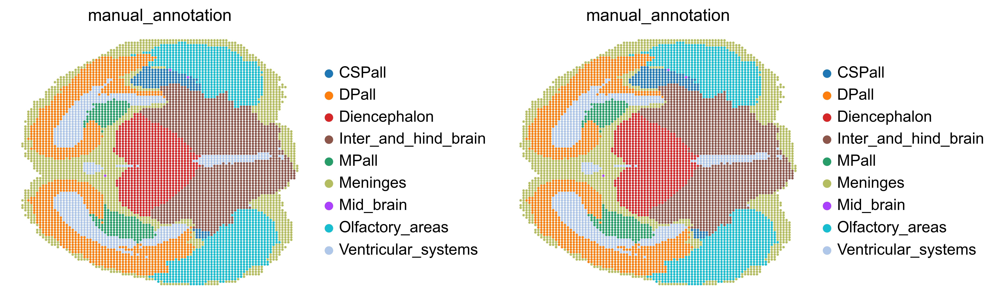

In [34]:
adata_STAX_fake_317 = adata_STAX_fake[adata_STAX_fake.obs.loc[:, 'z'] == 292. , ]
adata_STAX_fake_317
sc.pl.embedding(adata_STAX_fake_317, basis='spatial_3d_align', color=['manual_annotation', 'manual_annotation'], projection='2d', ncols=2, wspace=0.5, palette=color_d)

### From other view

#### Coronal

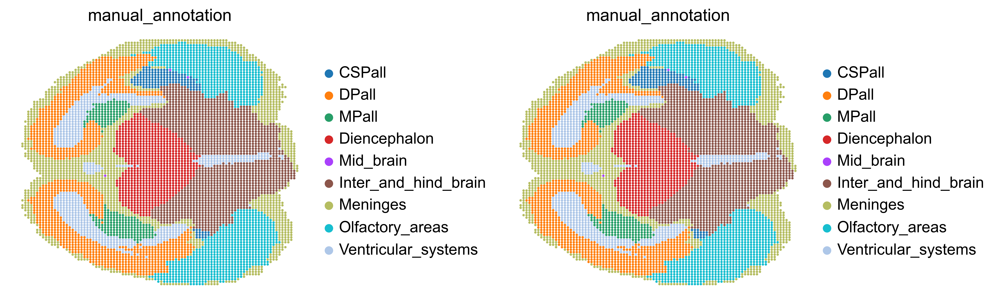

In [44]:
adata_STAX_fake_292 = adata_STAX_fake[adata_STAX_fake.obs.loc[:, 'z'] == 292. , ].copy()
adata_STAX_fake_292
sc.pl.embedding(adata_STAX_fake_292, basis='spatial_3d_align', color=['manual_annotation', 'manual_annotation'], projection='2d', ncols=2, wspace=0.5, palette=color_d)

#### Transverse

In [52]:
adata_STAX_fake

AnnData object with n_obs × n_vars = 550201 × 5000
    obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition', 'spot_quality', 'Region', 'slices', 'batch', 'x', 'y', 'kmeans', 'manual_annotation'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'kmeans_colors', 'manual_annotation_colors'
    obsm: 'X_STAX', 'spatial', 'spatial_3d_align'
    varm: 'gene_embedding'
    layers: 'counts', 'impute', 'norm_log', 'spliced', 'unspliced'

In [53]:
adata_STAX_fake.obs.loc[:, 'x'] = adata_STAX_fake.obsm['spatial_3d_align'][:, 0].astype(int)

In [54]:
len(np.unique(adata_STAX_fake.obs.loc[:, 'x']))

100

In [55]:
x = np.unique(adata_STAX_fake.obsm['spatial_3d_align'][:, 0])[20]
x

169.31312561035156

In [56]:
adata_STAX_fake_x_169 = adata_STAX_fake[adata_STAX_fake.obsm['spatial_3d_align'][:, 0] == x, :]
adata_STAX_fake_x_169.obsm['spatial_3d_align'][:, 0] = adata_STAX_fake_x_169.obsm['spatial_3d_align'][:, 1]
adata_STAX_fake_x_169.obsm['spatial_3d_align'][:, 1] = adata_STAX_fake_x_169.obsm['spatial_3d_align'][:, 2]
adata_STAX_fake_x_169

C:\Users\10360\AppData\Local\Temp\ipykernel_5820\1159986989.py:2: ImplicitModificationWarning: Trying to modify attribute `.obsm` of view, initializing view as actual.
  adata_STAX_fake_x_169.obsm['spatial_3d_align'][:, 0] = adata_STAX_fake_x_169.obsm['spatial_3d_align'][:, 1]


AnnData object with n_obs × n_vars = 5099 × 5000
    obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition', 'spot_quality', 'Region', 'slices', 'batch', 'x', 'y', 'kmeans', 'manual_annotation'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'kmeans_colors', 'manual_annotation_colors'
    obsm: 'X_STAX', 'spatial', 'spatial_3d_align'
    varm: 'gene_embedding'
    layers: 'counts', 'impute', 'norm_log', 'spliced', 'unspliced'

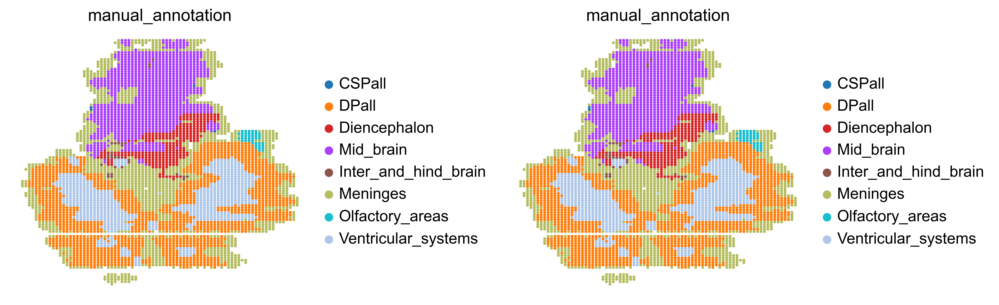

In [57]:
sc.pl.embedding(adata_STAX_fake_x_169, basis='spatial_3d_align', color=['manual_annotation', 'manual_annotation'], projection='2d', ncols=2, wspace=0.5, palette=color_d)

#### Sagittal

In [59]:
adata_STAX_fake_x_169

AnnData object with n_obs × n_vars = 5099 × 5000
    obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition', 'spot_quality', 'Region', 'slices', 'batch', 'x', 'y', 'kmeans', 'manual_annotation'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'kmeans_colors', 'manual_annotation_colors'
    obsm: 'X_STAX', 'spatial', 'spatial_3d_align'
    varm: 'gene_embedding'
    layers: 'counts', 'impute', 'norm_log', 'spliced', 'unspliced'

In [60]:
adata_STAX_fake.obs.loc[:, 'y'] = adata_STAX_fake.obsm['spatial_3d_align'][:, 1].astype(int)

In [61]:
len(np.unique(adata_STAX_fake.obs.loc[:, 'y']))

100

In [62]:
y = np.unique(adata_STAX_fake.obsm['spatial_3d_align'][:, 1])[30]
y

223.4545440673828

In [63]:
adata_STAX_fake_y_223 = adata_STAX_fake[adata_STAX_fake.obsm['spatial_3d_align'][:, 1] == y, :]
adata_STAX_fake_y_223.obsm['spatial_3d_align'][:, 1] = adata_STAX_fake_y_223.obsm['spatial_3d_align'][:, 2]
adata_STAX_fake_y_223

C:\Users\10360\AppData\Local\Temp\ipykernel_5820\1226067118.py:2: ImplicitModificationWarning: Trying to modify attribute `.obsm` of view, initializing view as actual.
  adata_STAX_fake_y_223.obsm['spatial_3d_align'][:, 1] = adata_STAX_fake_y_223.obsm['spatial_3d_align'][:, 2]


AnnData object with n_obs × n_vars = 7534 × 5000
    obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'z', 'region', 'color_list', 'color_seq', 'col', 'row', 'height', 'condition', 'spot_quality', 'Region', 'slices', 'batch', 'x', 'y', 'kmeans', 'manual_annotation'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'kmeans_colors', 'manual_annotation_colors'
    obsm: 'X_STAX', 'spatial', 'spatial_3d_align'
    varm: 'gene_embedding'
    layers: 'counts', 'impute', 'norm_log', 'spliced', 'unspliced'

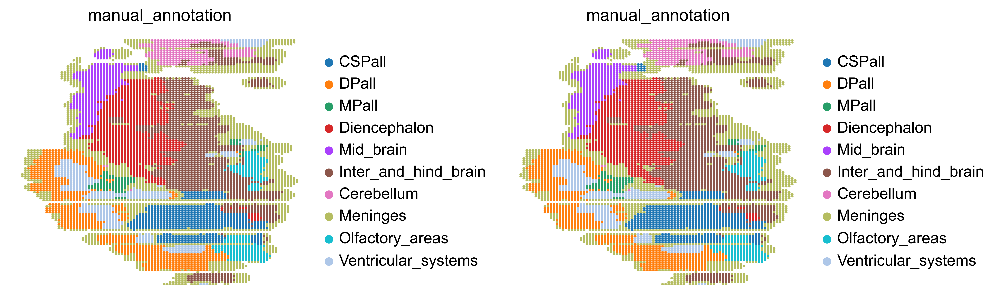

In [64]:
sc.pl.embedding(adata_STAX_fake_y_223, basis='spatial_3d_align', color=['manual_annotation', 'manual_annotation'], projection='2d', ncols=2, wspace=0.5, palette=color_d)